# Overview
- base: nb017
- bssid_pos を floor毎に利用する
- floor毎なので、testデータには、acc99%のデータを使う必要がある

In [1]:
import subprocess
cmd = "git rev-parse --short HEAD"
hash = subprocess.check_output(cmd.split()).strip().decode('utf-8')
print(hash)

1c30b36


# Const

In [2]:
NB = '019'
DIR_TRAIN = './../data_ignore/input/train/'
DIR_TEST = './../data_ignore/input/test/'
DIR_WIFI = './../data_ignore/input/wifi/'
PATH_SUB = './../data_ignore/input/sample_submission.csv'
PATH_99_SUB = './../data/input/floor_99per_acc_sub.csv'
DIR_SAVE_IGNORE = f'./../data_ignore/nb/{NB}/'
DIR_SAVE = f'./../data/nb/{NB}/'

In [3]:
config_str = '''
globals:
    seed: 5713
    device: cuda
    n_label: 24
    n_splits: 5
    random_sate: 42
    lr: 0.001
    patience: 10
    epoch: 100
    batch_size: 128
    skip_evaluate_num: 5
    num_feats: 20
    t_mux: 10
'''

In [4]:
map_floor = {
    'B2': -2, 'B1': -1, 'F1': 0, 'F2': 1, 'F3': 2, 'F4': 3, 'F5': 4, 'F6': 5, 'F7': 6, 'F8': 7, 'F9': 8,
    
    '2B': -2, '1B': -1, '1F': 0, '2F': 1, '3F': 2, '4F': 3, '5F': 4, '6F': 5, '7F': 6, '8F': 7, '9F': 8,
    }

# Import everything I need:)

In [5]:
import os
import json
import yaml
import types
import random
import pickle
import builtins
import numpy as np
import pandas as pd
from PIL import Image
from icecream import ic
# from tqdm import tqdm
import matplotlib.pyplot as plt
from fastprogress import progress_bar, master_bar
from glob import glob
from loguru import logger
from collections import OrderedDict

# sklearn
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import KFold

# pytorch
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
import torch.nn.functional as F

# Function

In [6]:
def imports():
    for name, val in globals().items():
        # module imports
        if isinstance(val, types.ModuleType):
            yield name, val

            # functions / callables
        if hasattr(val, '__call__'):
            yield name, val


def noglobal(f):
    '''
    ref: https://gist.github.com/raven38/4e4c3c7a179283c441f575d6e375510c
    '''
    return types.FunctionType(f.__code__,
                              dict(imports()),
                              f.__name__,
                              f.__defaults__,
                              f.__closure__
                              )


def comp_metric(xhat, yhat, fhat, x, y, f):
    intermediate = np.sqrt(np.power(xhat-x, 2) + np.power(yhat-y, 2)) + 15 * np.abs(fhat-f)
    return intermediate.sum()/xhat.shape[0]

def seed_everything(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True


def visualize_submission(df_sub, dir_image_with_trace, dir_meta, show=True, dpi=100):
    map_floor = {'B2': -2, 'B1': -1, 'F1': 0, 'F2': 1, 'F3': 2, 'F4': 3, 'F5': 4, 'F6': 5, 'F7': 6, 'F8': 7, 'F9': 8,
                 '2B': -2, '1B': -1, '1F': 0, '2F': 1, '3F': 2, '4F': 3, '5F': 4, '6F': 5, '7F': 6, '8F': 7, '9F': 8}
    
    site_path_timestamp = df_sub.site_path_timestamp.values
    site_arr = []
    path_arr = []
    for val in site_path_timestamp:
        site, path, _ = val.split('_')
        site_arr.append(site)
        path_arr.append(path)
    site_arr = np.array(site_arr)
    path_arr = np.array(path_arr)

    x_arr = df_sub.x.values
    y_arr = df_sub.y.values
    floor_arr = df_sub.floor.values
    
    # site loop
    for site in sorted(np.unique(site_arr)):
        floor_list = sorted(glob(f'{dir_image_with_trace}{site}/*'))
        floor_list = [text.split('/')[-1] for text in floor_list]
        
        # 画像の比を決めるために一度floor_info.jsonを取得
        path_json = f'{dir_meta}{site}/{floor_list[0]}/floor_info.json'
        with open(path_json) as json_file:
            json_data = json.load(json_file)
        _width_meter = json_data["map_info"]["width"]
        _height_meter = json_data["map_info"]["height"]
        s = max(_width_meter, _height_meter)

        # figとaxesの用意
        n_floor = len(floor_list)
        n_row = int(np.ceil(n_floor / 3))
        w = round(5*3*_width_meter/s)
        h = round(5*n_row*_height_meter/s)
        fig, axs = plt.subplots(n_row, 3, figsize=(w, h), dpi=dpi)
        fig.suptitle(site, fontsize=15)
        fig.patch.set_facecolor('white')
        axs = axs.ravel()

        # floor loop
        for i_floor, floor in enumerate(floor_list):
            # json
            path_json = f'{dir_meta}{site}/{floor}/floor_info.json'
            with open(path_json) as json_file:
                json_data = json.load(json_file)
            width_meter = json_data["map_info"]["width"]
            height_meter = json_data["map_info"]["height"]

            # show image
            path_img = f'{dir_image_with_trace}{site}/{floor}/floor_image_with_trace.png'
            im = Image.open(path_img)
            axs[i_floor].imshow(np.asarray(im), extent=(0, width_meter, 0, height_meter))
            axs[i_floor].set_title(floor, fontsize=10)

            # draw path
            logics_site_floor = (site_arr == site) & (floor_arr == map_floor[floor])
            for path in sorted(np.unique(path_arr[logics_site_floor])):
                logics_path = path_arr == path
                x_arr_path = x_arr[logics_path]
                y_arr_path = y_arr[logics_path]

                axs[i_floor].plot(x_arr_path, y_arr_path, linewidth=1, color='black')
        if show:
            display(fig)

# Preparation

load config

In [7]:
config = yaml.safe_load(config_str)
config

{'globals': {'seed': 5713,
  'device': 'cuda',
  'n_label': 24,
  'n_splits': 5,
  'random_sate': 42,
  'lr': 0.001,
  'patience': 10,
  'epoch': 100,
  'batch_size': 128,
  'skip_evaluate_num': 5,
  'num_feats': 20,
  't_mux': 10}}

<br>

set

In [8]:
seed_everything(config['globals']['seed'])

if not os.path.exists(DIR_SAVE_IGNORE):
    os.makedirs(DIR_SAVE_IGNORE)
if not os.path.exists(DIR_SAVE):
    os.makedirs(DIR_SAVE)

In [9]:
bssid_feats = [f'bssid_{i}' for i in range(config['globals']['num_feats'])]
rssi_feats  = [f'rssi_{i}' for i in range(config['globals']['num_feats'])]

<br>

load dataset

In [10]:
sample_submission = pd.read_csv(PATH_SUB)
submission_99per_acc = pd.read_csv(PATH_99_SUB)

In [11]:
with open(f'{DIR_WIFI}train_all.pkl', 'rb') as f:
    df_train = pickle.load( f)
with open(f'{DIR_WIFI}test_all.pkl', 'rb') as f:
    df_test = pickle.load( f)

In [12]:
df_list = []
for path in sorted(glob('./../data/nb/013/*.csv')):
    df_list.append(pd.read_csv(path))
df_wifi_pos = pd.concat(df_list, axis=0)

In [13]:
df_wifi_pos['floor_id'] = df_wifi_pos['floor'].map(map_floor)

<br>

merge

In [14]:
# floorで丸めない
df_wifi_pos_grp_floor = df_wifi_pos.groupby(['bssid', 'site', 'floor']).mean().reset_index(drop=False).copy()

In [15]:
# test に 推論したfloorを追加
df_test = df_test.merge(submission_99per_acc[['site_path_timestamp', 'floor']],
                        how='left', left_on='site_path_timestamp', right_on='site_path_timestamp'
                       )

In [16]:
%%time
# train
# df_train = df_train.copy()
for i, bssid in enumerate(progress_bar(bssid_feats)):
    df_train = df_train.merge(df_wifi_pos_grp_floor[['bssid', 'bssid_x', 'bssid_y', 'site', 'floor_id']],
                               how='left', left_on=[bssid, 'site_id', 'floor'], right_on=['bssid', 'site', 'floor_id']
                              ).drop(['bssid', 'site', 'floor_id'], axis=1
                                    ).rename({'bssid_x': f'bssid_x_{i}', 'bssid_y': f'bssid_y_{i}'}, axis=1)

CPU times: user 1min 34s, sys: 13.6 s, total: 1min 48s
Wall time: 1min 48s


In [17]:
%%time
#test
for i, bssid in enumerate(progress_bar(bssid_feats)):
    df_test = df_test.merge(df_wifi_pos_grp_floor[['bssid', 'bssid_x', 'bssid_y', 'site', 'floor_id']],
                               how='left', left_on=[bssid, 'site_id', 'floor'], right_on=['bssid', 'site', 'floor_id']
                              ).drop(['bssid', 'site', 'floor_id'], axis=1
                                    ).rename({'bssid_x': f'bssid_x_{i}', 'bssid_y': f'bssid_y_{i}'}, axis=1)

CPU times: user 4.01 s, sys: 36.1 ms, total: 4.05 s
Wall time: 4.04 s


In [18]:
bssid_x_feats = [f'bssid_x_{i}' for i in range(config['globals']['num_feats'])]
bssid_y_feats = [f'bssid_y_{i}' for i in range(config['globals']['num_feats'])]

bssid_x_mean = df_wifi_pos_grp_floor['bssid_x'].mean()
bssid_y_mean = df_wifi_pos_grp_floor['bssid_y'].mean()

<br>

nanを埋める

In [19]:
df_train[bssid_x_feats] = df_train[bssid_x_feats].fillna(value=bssid_x_mean)
df_train[bssid_y_feats] = df_train[bssid_y_feats].fillna(value=bssid_y_mean)
df_test[bssid_x_feats] = df_test[bssid_x_feats].fillna(value=bssid_x_mean)
df_test[bssid_y_feats] = df_test[bssid_y_feats].fillna(value=bssid_y_mean)

<br>

preprocessing

In [20]:
# bssidの一覧作成
# wifi_bassidにはtrainとtest両方のbssidの一覧が含まれる

wifi_bssids = []
for i in range(config['globals']['num_feats']):
    wifi_bssids.extend(df_train.iloc[:,i].values.tolist())
wifi_bssids = list(set(wifi_bssids))

wifi_bssids_size = len(wifi_bssids)
print(f'BSSID TYPES: {wifi_bssids_size}')

wifi_bssids_test = []
for i in range(config['globals']['num_feats']):
    wifi_bssids_test.extend(df_test.iloc[:,i].values.tolist())
wifi_bssids_test = list(set(wifi_bssids_test))

wifi_bssids_size = len(wifi_bssids_test)
print(f'BSSID TYPES: {wifi_bssids_size}')

wifi_bssids.extend(wifi_bssids_test)
wifi_bssids_size = len(wifi_bssids)
print(f'BSSID TYPES: {wifi_bssids_size}')

BSSID TYPES: 43722
BSSID TYPES: 19239
BSSID TYPES: 62961


In [21]:
# LabelEncoding & StandardScaler

le = LabelEncoder()
le.fit(wifi_bssids)
le_site = LabelEncoder()
le_site.fit(df_train['site_id'])

ss = StandardScaler()
ss.fit(df_train.loc[:, rssi_feats])

StandardScaler()

In [22]:
df_train.loc[:, rssi_feats] = ss.transform(df_train.loc[:, rssi_feats])
df_test.loc[:, rssi_feats] = ss.transform(df_test.loc[:, rssi_feats])
for feat in bssid_feats:
    df_train.loc[:, feat] = le.transform(df_train.loc[:, feat])
    df_test.loc[:, feat] = le.transform(df_test.loc[:, feat])
    
    df_train.loc[:, feat] = df_train.loc[:, feat] + 1
    df_test.loc[:, feat] = df_test.loc[:, feat] + 1
    
df_train.loc[:, 'site_id'] = le_site.transform(df_train.loc[:, 'site_id'])
df_test.loc[:, 'site_id'] = le_site.transform(df_test.loc[:, 'site_id'])

# df_train.loc[:, rssi_feats] = ss.transform(df_train.loc[:, rssi_feats])
# df_test.loc[:, rssi_feats] = ss.transform(df_test.loc[:, rssi_feats])

In [23]:
site_count = len(df_train['site_id'].unique())
df_train.reset_index(drop=True, inplace=True)

In [24]:
df_train.head()

,bssid_0,bssid_1,bssid_2,bssid_3,bssid_4,bssid_5,bssid_6,bssid_7,bssid_8,bssid_9,...,bssid_x_15,bssid_y_15,bssid_x_16,bssid_y_16,bssid_x_17,bssid_y_17,bssid_x_18,bssid_y_18,bssid_x_19,bssid_y_19
0,37721,25790,1987,25076,37930,25352,30791,24095,16874,11019,...,110.573173,148.646173,110.632967,148.565746,110.582382,148.633790,87.504300,176.090487,110.254738,149.073429
1,25790,37721,5388,25076,37930,25352,15819,11019,12292,3855,...,87.504300,176.090487,87.456688,176.145208,110.112255,149.838047,90.202295,174.246378,110.582382,148.633790
2,25790,37721,37930,25076,25352,16874,35606,4811,5388,34934,...,104.314063,175.503640,87.456688,176.145208,87.504300,176.090487,103.927752,175.106895,104.308791,175.498171
3,16874,25076,25352,37721,25790,2691,35606,11293,7294,3594,...,110.112255,149.838047,112.153877,139.631704,90.202295,174.246378,110.632967,148.565746,102.452377,174.584122
4,25790,25352,16874,14039,37721,2691,35606,13209,15413,37991,...,104.308791,175.498171,104.303256,175.492409,104.319090,175.508834,104.328463,175.518464,104.314063,175.503640


# Execute

In [25]:
class EarlyStopping:
    """
    Early stops the training if validation loss doesn't improve after a given patience.
    based on: https://github.com/Bjarten/early-stopping-pytorch
    """
    def __init__(self, save_name, fold, patience=7, verbose=False, delta=0):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
                            Default: 7
            verbose (bool): If True, prints a message for each validation loss improvement. 
                            Default: False
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
                            Default: 0
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.Inf
        self.delta = delta
        self.fold = fold
        self.save_name = save_name

    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            logger.info(f'EarlyStopping counter: {self.counter} out of {self.patience}, score={val_loss}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            logger.info(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
            
        torch.save(model.state_dict(),  f'{self.save_name}_{self.fold}.pt')
        self.val_loss_min = val_loss

In [26]:
class IndoorWiFiNet(nn.Module):
    def __init__(self, bssid_size, site_size, num_feats):
        super(IndoorWiFiNet, self).__init__()
        self.bssid_embedding = nn.Embedding(bssid_size, 64, max_norm=True)
        self.site_embedding = nn.Embedding(site_size, 64, max_norm=True)

        self.rssi = nn.Sequential(
            nn.BatchNorm1d(20),
            nn.Linear(20, num_feats * 64)
#             nn.BatchNorm1d(20*3),
#             nn.Linear(20*3, num_feats * 64 *3)
        )
        self.bssid_x = nn.Sequential(
            nn.BatchNorm1d(20),
            nn.Linear(20, num_feats * 64)
        )
        self.bssid_y = nn.Sequential(
            nn.BatchNorm1d(20),
            nn.Linear(20, num_feats * 64)
        )

        concat_size = 64 + (num_feats * 64) + (num_feats * 64) + (num_feats * 64) + (num_feats * 64)
        self.bn1 = nn.BatchNorm1d(concat_size)

        self.flatten = nn.Flatten()

        self.dropout1 = nn.Dropout(0.3)
        self.linear1 = nn.Linear(in_features=concat_size, out_features=256)#, bias=False)
        self.bn2 = nn.BatchNorm1d(256)

        self.linear2 = nn.Linear(in_features=256, out_features=128)#, bias=False)
        self.linear3 = nn.Linear(in_features=128, out_features=16)#, bias=False)

        self.bn3 = nn.BatchNorm1d(128)
        self.bn4 = nn.BatchNorm1d(16)


        self.xy = nn.Linear(in_features=16, out_features=2)#, bias=False)
        self.floor = nn.Linear(in_features=16, out_features=1)#, bias=False)
        

    def forward(self, bssid, rssi, site, bssid_x, bssid_y):
#     def forward(self, bssid, rssi, site):

        site = torch.reshape(site, (-1, 1))

        bssid_out = self.bssid_embedding(bssid)
        site_out = self.site_embedding(site)

        rssi_out = self.rssi(rssi)
        bssid_x_out = self.bssid_x(bssid_x)
        bssid_y_out = self.bssid_y(bssid_y)

        bssid_out = self.flatten(bssid_out)
        site_out = self.flatten(site_out)

        x = torch.cat([bssid_out, rssi_out, site_out, bssid_x_out, bssid_y_out], dim=1)
#         x = torch.cat([bssid_out, rssi_out, site_out], dim=1)
        x = self.bn1(x)
        x = self.dropout1(x)
        x = F.relu(self.linear1(x))
        x = self.bn2(x)

        x = F.relu(self.linear2(x))
        x = self.bn3(x)

        x = F.relu(self.linear3(x))
        x = self.bn4(x)

        #x = self.lstm(x)

        xy = self.xy(x)
        floor = self.floor(x)

        return xy, floor

In [27]:
class IndoorWiFiDataSet(Dataset):
    def __init__(self, wifi_df, bssid_feats_, rssi_feats_, bssid_x_feats_, bssid_y_feats_, data_type='test'):
        self.wifi_df = wifi_df
        self.data_type = data_type
        self.bssids = wifi_df[bssid_feats_].to_numpy().astype(np.int)    # <----- リファクタ
        self.rssis = wifi_df[rssi_feats_].to_numpy().astype(np.float)    # <----- リファクタ
        
        self.bssid_x = wifi_df[bssid_x_feats_].to_numpy().astype(np.float)
        self.bssid_y = wifi_df[bssid_y_feats_].to_numpy().astype(np.float)
        
        self.site_ids = wifi_df['site_id'].to_numpy()
        if data_type in ['train', 'valid']:
            self.floors = wifi_df['floor'].to_numpy().astype(np.int)
            self.xs = wifi_df['x'].to_numpy()
            self.ys = wifi_df['y'].to_numpy()
        
    def __len__(self):
        return len(self.wifi_df)

    def __getitem__(self, idx):
        # wifi_row = self.wifi_df.iloc[idx]
        bssid = self.bssids[idx, :]
        rssi = self.rssis[idx, :]
        site_id = self.site_ids[idx]
        
        bssid_x = self.bssid_x[idx, :]
        bssid_y = self.bssid_y[idx, :]

        if self.data_type in ['test', 'valid']:
            return bssid, rssi, site_id, bssid_x, bssid_y

        elif self.data_type == 'train':
            x = self.xs[idx]
            y = self.ys[idx]
            floor = self.floors[idx]

            return bssid, rssi, site_id, x, y, floor, bssid_x, bssid_y


In [28]:
class IndoorLoss(nn.Module):
    def __init__(self):
        super().__init__()

        self.mse = nn.MSELoss()

    def forward(self, x, y, floor, x_pred, y_pred, floor_pred):

        x_loss = self.mse(x, x_pred)
        y_loss = self.mse(y, y_pred)
        floor_loss = self.mse(floor, floor_pred)

        return x_loss + y_loss + floor_loss

In [29]:
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device = torch.device(config['globals']['device'])

In [30]:
%%time

oof_x = np.zeros((len(df_train)))
oof_y = np.zeros((len(df_train)))
oof_floor = np.zeros((len(df_train)))
cv_scores = {}

kf = KFold(n_splits=config['globals']['n_splits'], random_state=42, shuffle=True)
for fold, (train_index, valid_index) in enumerate(kf.split(df_train)):
    print(f'\r\n====== {fold + 1} ======')
    net = IndoorWiFiNet(wifi_bssids_size, site_count, config['globals']['num_feats'])
    net = net.to(device)

    #criterion = IndoorLoss()
    criterion = nn.MSELoss()
    criterion = criterion.to(device)
#     optimizer = optim.SGD(net.parameters(), lr=config['globals']['lr'], weight_decay=0.0001, momentum=0.9)
#     optimizer = optim.SGD(net.parameters(), lr=config['globals']['lr'], momentum=0.9)
    optimizer = torch.optim.Adam(net.parameters(), lr=config['globals']['lr'])
    
    train, valid = df_train.iloc[train_index], df_train.iloc[valid_index]

    train_dataset = IndoorWiFiDataSet(train.reset_index(drop=True), bssid_feats, rssi_feats, bssid_x_feats, bssid_y_feats, data_type='train')
    valid_dataset = IndoorWiFiDataSet(valid.reset_index(drop=True), bssid_feats, rssi_feats, bssid_x_feats, bssid_y_feats, data_type='valid')

    trainloader = DataLoader(train_dataset, batch_size=config['globals']['batch_size'], shuffle=True, drop_last=True, num_workers=4)
    validloader = DataLoader(valid_dataset, batch_size=config['globals']['batch_size'], num_workers=4)

    early_stopping = EarlyStopping(save_name=f'{DIR_SAVE_IGNORE}checkpoint_{NB}', fold=fold+1, patience=config['globals']['patience'], verbose=True)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=config['globals']['t_mux'])


    ############# TRAIN #############
    val_losses = []
    val_metrics = []
    mb = master_bar(range(1, config['globals']['epoch']+1))
    for epoch in mb:
        mb.main_bar.comment = f'epoch = {epoch}'
        running_loss = 0.0
        #train_lwlrap = 0.0
#         n_iter = len(trainloader)
#         with tqdm(enumerate(trainloader), total=n_iter) as pbar:
        for i, (bssid, rssi, site_id, x, y, floor, bssid_x, bssid_y) in enumerate(progress_bar(trainloader, parent=mb)):
            net.train()
            # zero the parameter gradients
            optimizer.zero_grad()

            bssid, rssi, site_id, x, y, floor, bssid_x, bssid_y = bssid.to(device).long(), rssi.to(device).float(), site_id.to(device).long(), x.to(device).float(), y.to(device).float(), floor.to(device), bssid_x.to(device).float(), bssid_y.to(device).float()

            xy_pred, floor_pred = net(bssid, rssi, site_id, bssid_x, bssid_y)
#             xy_pred, floor_pred = net(bssid, torch.cat([rssi, bssid_x, bssid_y], dim=1), site_id)
            xy_pred = xy_pred.transpose(0, 1).squeeze(-2).reshape(-1)
            label = torch.cat([x, y], dim=-1)
            loss = criterion(xy_pred, label)
            #loss = criterion(x, y, floor, x_pred, y_pred, floor_pred)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
#             mb.child.comment(OrderedDict(
#                 epoch="{:>10}".format(epoch), loss="{:.4f}".format(loss.item())
#             ))
            mb.child.comment = f'loss={loss.item():.4f}'
        scheduler.step()
            
        #if epoch < Config.SKIP_EVALUATE_NUM:
        #    continue

        ############# VALID #############
        val_loss = 0.0
        val_lwlrap = 0.0
        x_preds = np.array([])
        y_preds = np.array([])
        val_preds_frame = []
        n_iter_val = len(validloader)
#         for i, (bssid, rssi, site_id) in tqdm(enumerate(validloader), total=len(validloader)):
        for i, (bssid, rssi, site_id, bssid_x, bssid_y) in enumerate(progress_bar(validloader, parent=mb)):
            mb.child.comment = 'calc valid'
            net.eval()

            with torch.no_grad():
                
                #melspec, labels = melspec.to(device).float(), labels.to(device).float()
                bssid, rssi, site_id, bssid_x, bssid_y = bssid.to(device).long(), rssi.to(device).float(), site_id.to(device).long(), bssid_x.to(device).float(), bssid_y.to(device).float()
                xy_pred, floor_pred = net(bssid, rssi, site_id, bssid_x, bssid_y)

                xy_pred = xy_pred.to('cpu').detach().numpy().copy()
                x_pred, y_pred = np.hsplit(xy_pred, 2)
                x_preds = np.concatenate([x_preds, x_pred.reshape(-1)])
                y_preds = np.concatenate([y_preds, y_pred.reshape(-1)])

        score = comp_metric(x_preds, y_preds, 0, valid['x'], valid['y'], 0)

        early_stopping(score, net)

        if early_stopping.early_stop:
            logger.info("Early stopping")
            cv_scores[f'cv{fold + 1}'] = early_stopping.best_score
            break
                
    _x_oof = np.array([])
    _y_oof = np.array([])
    ############# OOF #############
    oof_preds = []
#     for i, (bssid, rssi, site_id) in tqdm(enumerate(validloader), total=len(validloader)):
    for i, (bssid, rssi, site_id, bssid_x, bssid_y) in enumerate(progress_bar(validloader, parent=mb)):
#         net.load_state_dict(torch.load(ROOT_DIR / Path('output') / f'checkpoint_{NB}_{fold}.pt'))
        net.load_state_dict(torch.load(f'{DIR_SAVE_IGNORE}checkpoint_{NB}_{fold + 1}.pt'))
        net.eval()

        with torch.no_grad():

#             bssid, rssi, site_id, x, y, floor = bssid.to(device).long(), rssi.to(device).float(), site_id.to(device).long(), x.to(device).float(), y.to(device).float(), floor.to(device)
            bssid, rssi, site_id, x, y, floor, bssid_x, bssid_y = bssid.to(device).long(), rssi.to(device).float(), site_id.to(device).long(), x.to(device).float(), y.to(device).float(), floor.to(device), bssid_x.to(device).float(), bssid_y.to(device).float()

            xy_pred, floor_pred = net(bssid, rssi, site_id, bssid_x, bssid_y)

            xy_pred = xy_pred.to('cpu').detach().numpy().copy()
            x_pred, y_pred = np.hsplit(xy_pred, 2)
            _x_oof = np.concatenate([_x_oof, x_pred.reshape(-1)])
            _y_oof = np.concatenate([_y_oof, y_pred.reshape(-1)])

    print(comp_metric(_x_oof, _y_oof, 0, valid['x'], valid['y'], 0))

    oof_x[valid_index] = _x_oof
    oof_y[valid_index] = _y_oof

    del net
    torch.cuda.empty_cache()


====== 1 ======


2021-04-08 17:40:33.282 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (inf --> 80.127093).  Saving model ...
2021-04-08 17:40:47.692 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (80.127093 --> 9.279370).  Saving model ...
2021-04-08 17:41:02.497 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (9.279370 --> 7.546687).  Saving model ...
2021-04-08 17:41:17.097 | INFO     | __main__:__call__:35 - EarlyStopping counter: 1 out of 10, score=7.568489328502535
2021-04-08 17:41:31.590 | INFO     | __main__:__call__:35 - EarlyStopping counter: 2 out of 10, score=8.14995649882159
2021-04-08 17:41:46.194 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (7.546687 --> 6.922120).  Saving model ...
2021-04-08 17:42:00.495 | INFO     | __main__:__call__:35 - EarlyStopping counter: 1 out of 10, score=7.424384029448334
2021-04-08 17:42:14.875 | INFO     | __main__:__call__:35 - EarlyStopping counter: 2 out of 10, scor

6.710986781583732

====== 2 ======


2021-04-08 17:45:15.823 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (inf --> 80.796304).  Saving model ...
2021-04-08 17:45:30.461 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (80.796304 --> 9.843139).  Saving model ...
2021-04-08 17:45:45.162 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (9.843139 --> 7.534344).  Saving model ...
2021-04-08 17:45:58.736 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (7.534344 --> 6.998581).  Saving model ...
2021-04-08 17:46:13.458 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (6.998581 --> 6.748007).  Saving model ...
2021-04-08 17:46:28.030 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (6.748007 --> 6.703695).  Saving model ...
2021-04-08 17:46:42.602 | INFO     | __main__:__call__:35 - EarlyStopping counter: 1 out of 10, score=7.2901920950117285
2021-04-08 17:46:56.902 | INFO     | __main__:__call__:35 - EarlyS

6.7036948915183

====== 3 ======


2021-04-08 17:49:13.037 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (inf --> 76.722386).  Saving model ...
2021-04-08 17:49:27.584 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (76.722386 --> 8.954086).  Saving model ...
2021-04-08 17:49:41.842 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (8.954086 --> 8.300940).  Saving model ...
2021-04-08 17:49:56.581 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (8.300940 --> 7.210533).  Saving model ...
2021-04-08 17:50:11.138 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (7.210533 --> 6.934752).  Saving model ...
2021-04-08 17:50:25.816 | INFO     | __main__:__call__:35 - EarlyStopping counter: 1 out of 10, score=7.271759600248507
2021-04-08 17:50:40.403 | INFO     | __main__:__call__:35 - EarlyStopping counter: 2 out of 10, score=7.331346326815277
2021-04-08 17:50:55.144 | INFO     | __main__:save_checkpoint:46 - Validation loss 

6.7485163210441135

====== 4 ======


2021-04-08 17:54:55.653 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (inf --> 75.881948).  Saving model ...
2021-04-08 17:55:10.036 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (75.881948 --> 11.642198).  Saving model ...
2021-04-08 17:55:24.716 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (11.642198 --> 7.708168).  Saving model ...
2021-04-08 17:55:38.636 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (7.708168 --> 7.516578).  Saving model ...
2021-04-08 17:55:53.208 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (7.516578 --> 6.924875).  Saving model ...
2021-04-08 17:56:07.434 | INFO     | __main__:__call__:35 - EarlyStopping counter: 1 out of 10, score=7.227427356980534
2021-04-08 17:56:21.518 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (6.924875 --> 6.835382).  Saving model ...
2021-04-08 17:56:35.636 | INFO     | __main__:__call__:35 - Early

6.708995046600869

====== 5 ======


2021-04-08 17:59:49.895 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (inf --> 76.268094).  Saving model ...
2021-04-08 18:00:04.402 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (76.268094 --> 8.970890).  Saving model ...
2021-04-08 18:00:19.082 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (8.970890 --> 7.455141).  Saving model ...
2021-04-08 18:00:34.043 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (7.455141 --> 7.430645).  Saving model ...
2021-04-08 18:00:48.269 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (7.430645 --> 6.989442).  Saving model ...
2021-04-08 18:01:02.980 | INFO     | __main__:__call__:35 - EarlyStopping counter: 1 out of 10, score=7.023929535702716
2021-04-08 18:01:17.191 | INFO     | __main__:save_checkpoint:46 - Validation loss decreased (6.989442 --> 6.942552).  Saving model ...
2021-04-08 18:01:31.761 | INFO     | __main__:__call__:35 - EarlySt

6.667630256321178
CPU times: user 20min 37s, sys: 2min 36s, total: 23min 13s
Wall time: 24min 44s


In [31]:
oof_score = comp_metric(oof_x, oof_y, np.zeros(len(df_train)), df_train['x'], df_train['y'], np.zeros(len(df_train)))
oof_score

6.70796465941364

# test

In [32]:
%%time
x_preds_mean = np.zeros(len(df_test))
y_preds_mean = np.zeros(len(df_test))

for fold in range(config['globals']['n_splits']):

    x_preds = np.array([])
    y_preds = np.array([])

    net = IndoorWiFiNet(wifi_bssids_size, site_count, config['globals']['num_feats'])
    net.to(device)
#     print(ROOT_DIR / Path('output') / f'load checkpoint_{NB}_{fold}.pt')
#     net.load_state_dict(torch.load(ROOT_DIR / Path('output') / f'checkpoint_{NB}_{fold}.pt'))
    net.load_state_dict(torch.load(f'{DIR_SAVE_IGNORE}checkpoint_{NB}_{fold + 1}.pt'))

    test_dataset = IndoorWiFiDataSet(df_test, bssid_feats, rssi_feats, bssid_x_feats, bssid_y_feats, data_type='test')
#     valid_dataset = IndoorWiFiDataSet(valid.reset_index(drop=True), bssid_feats, rssi_feats, bssid_x_feats, bssid_y_feats, data_type='valid')
#     valid_dataset = IndoorWiFiDataSet(valid.reset_index(drop=True), bssid_feats, rssi_feats, data_type='valid')
    testloader = DataLoader(test_dataset, batch_size=config['globals']['batch_size'], num_workers=4)
    
    test_preds = []
    for i, (bssid, rssi, site_id, bssid_x, bssid_y) in enumerate(progress_bar(testloader)):
        net.eval()
        with torch.no_grad():
            bssid, rssi, site_id, bssid_x, bssid_y = bssid.to(device).long(), rssi.to(device).float(), site_id.to(device).long(), bssid_x.to(device).float(), bssid_y.to(device).float()

            xy_pred, floor_pred = net(bssid, rssi, site_id, bssid_x, bssid_y)
            xy_pred = xy_pred.to('cpu').detach().numpy().copy()

            x_pred, y_pred = np.hsplit(xy_pred, 2)
            x_preds = np.concatenate([x_preds, x_pred.reshape(-1)])
            y_preds = np.concatenate([y_preds, y_pred.reshape(-1)])

    x_preds_mean += x_preds / config['globals']['n_splits']
    y_preds_mean += y_preds / config['globals']['n_splits']

CPU times: user 1.13 s, sys: 1.59 s, total: 2.72 s
Wall time: 12 s


In [33]:
x_preds_mean

array([ 88.29335632,  78.85610504,  78.18531189, ..., 203.44105225,
       201.48936768, 204.53198853])

In [34]:
df_xy_oof = pd.DataFrame()
df_xy_oof['oof_x'] = oof_x
df_xy_oof['oof_y'] = oof_y
df_xy_oof.to_csv(f'{DIR_SAVE}nb{NB}_oof_xy.csv', index=False)

In [35]:
pred_df = df_test[['site_path_timestamp']].copy()
pred_df['x'] = x_preds_mean
pred_df['y'] = y_preds_mean
sub = pred_df.merge(submission_99per_acc[['site_path_timestamp', 'floor']], how='left', on='site_path_timestamp')[['site_path_timestamp', 'floor', 'x', 'y']]

In [36]:
assert len(sample_submission.merge(sub, how='inner', on='site_path_timestamp')) == len(sample_submission)

In [37]:
sub_file_path = f'{DIR_SAVE}nb{NB}_sub.csv'
sub.to_csv(sub_file_path, index=False)

# Analysis

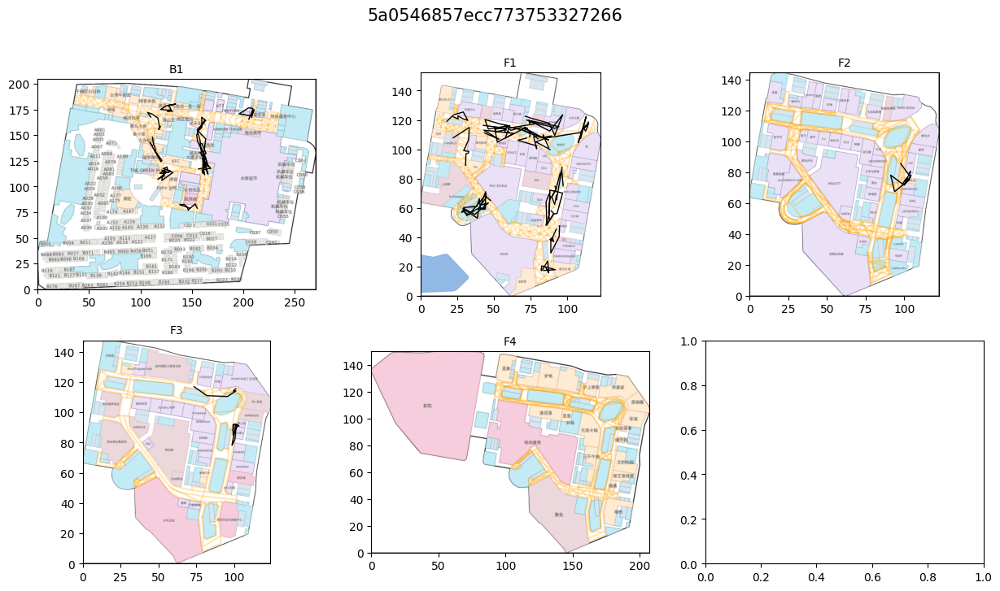

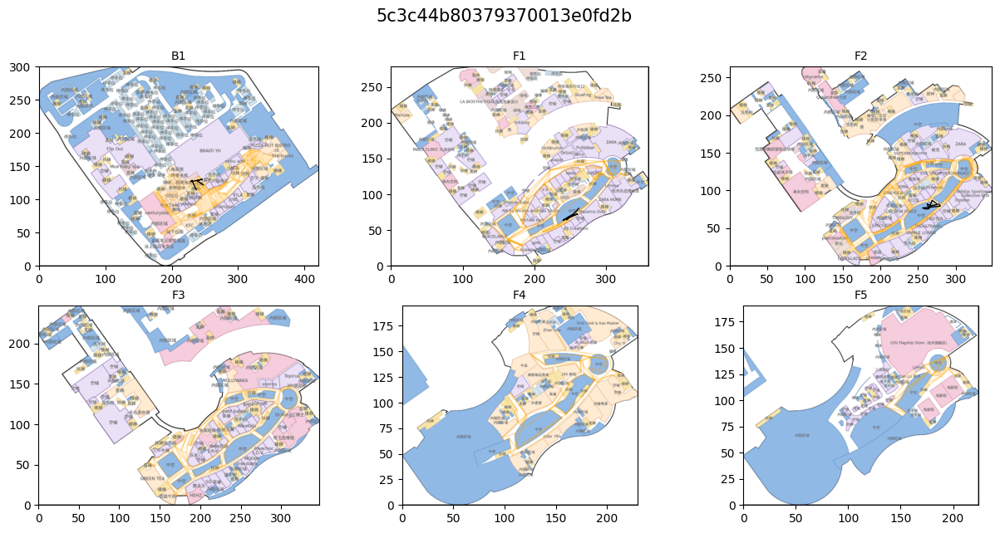

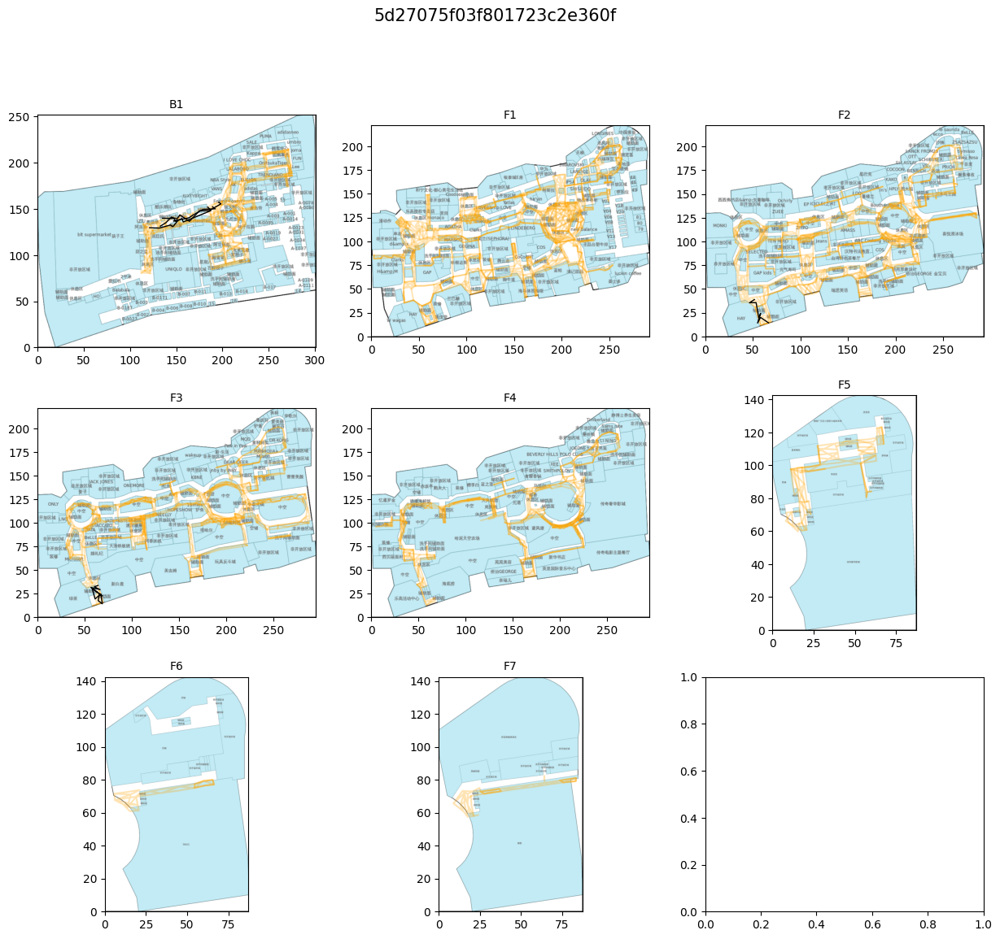

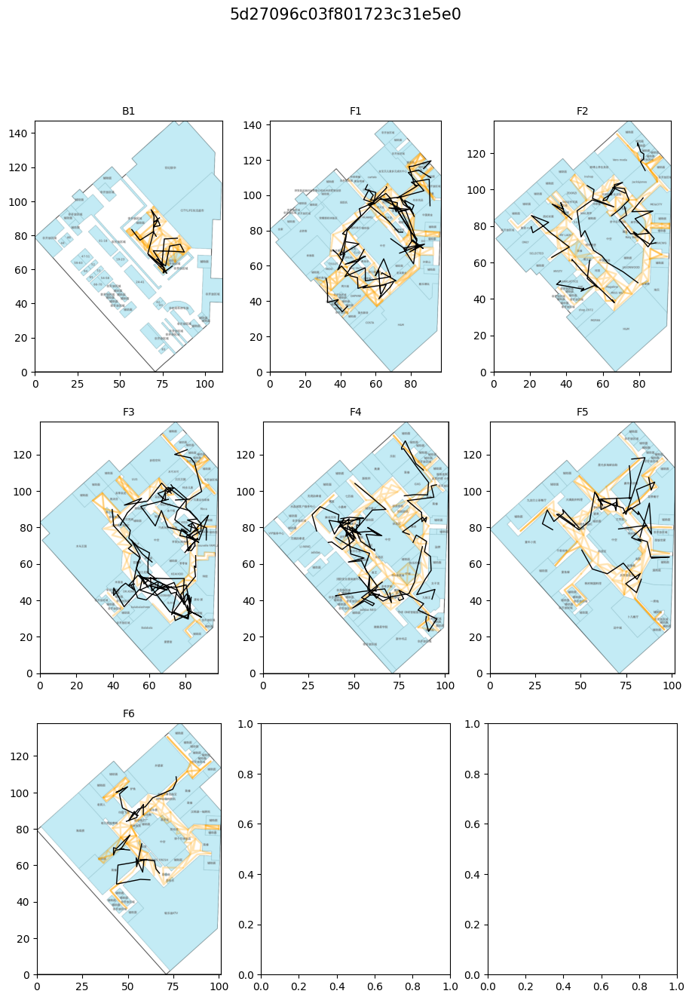

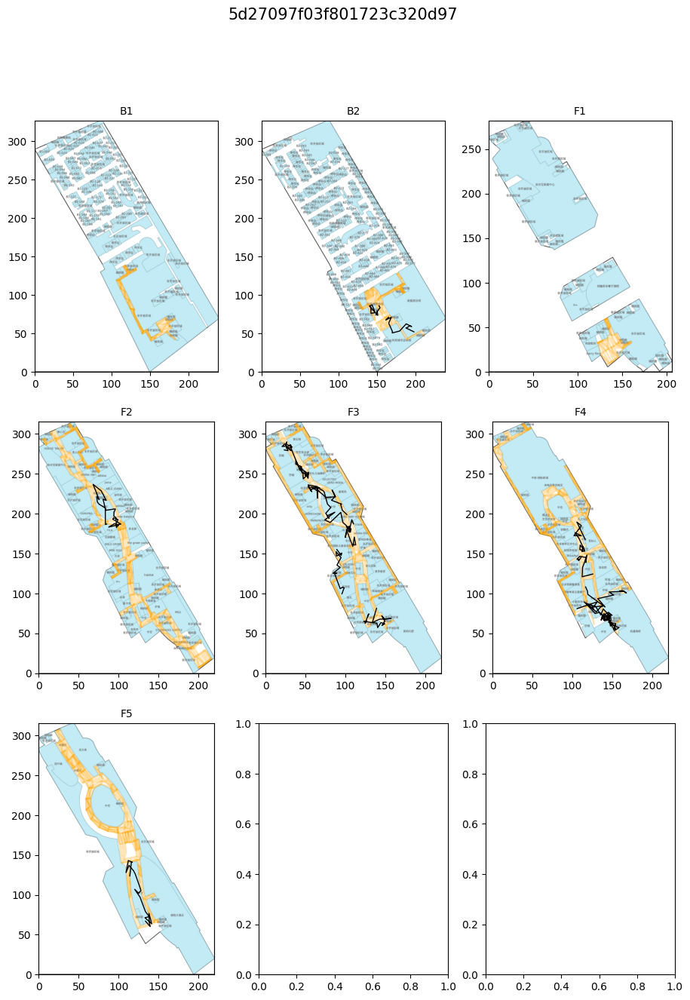

...

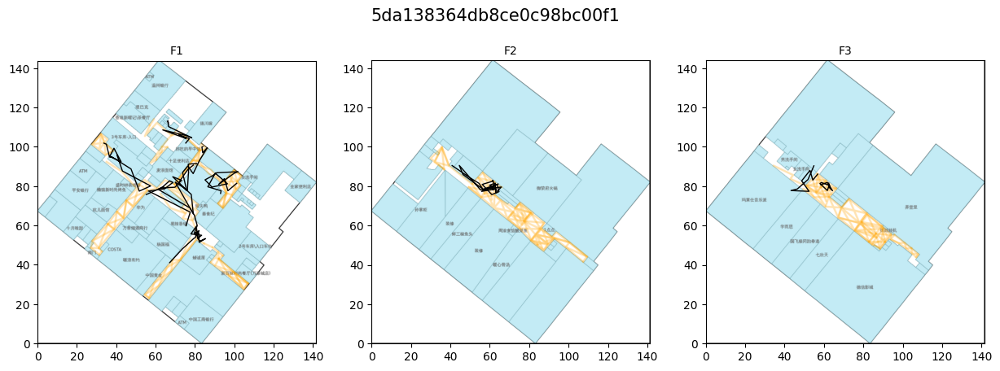

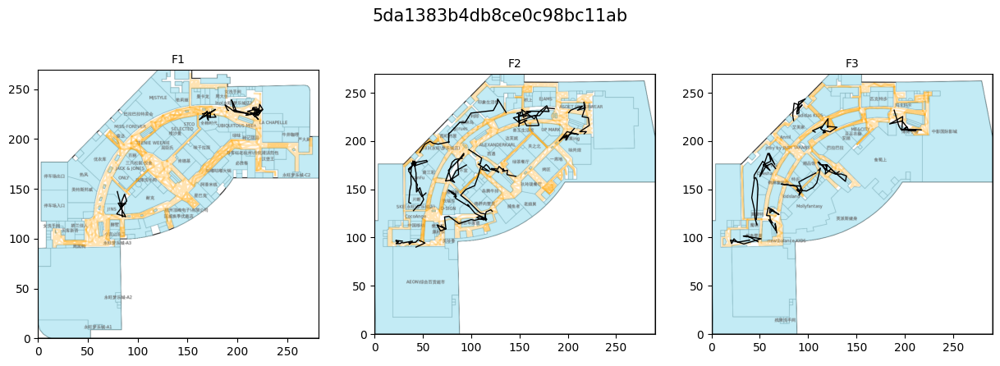

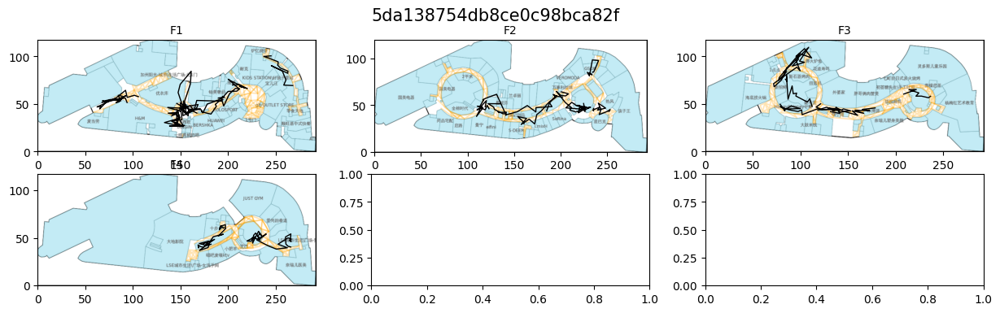

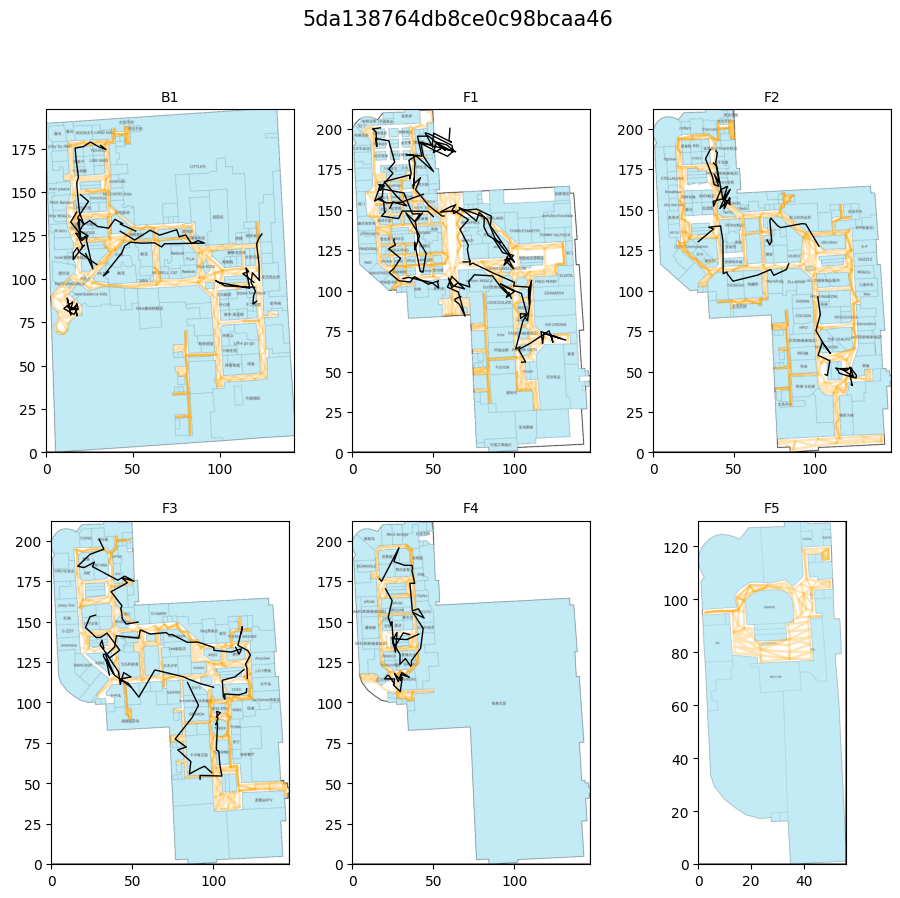

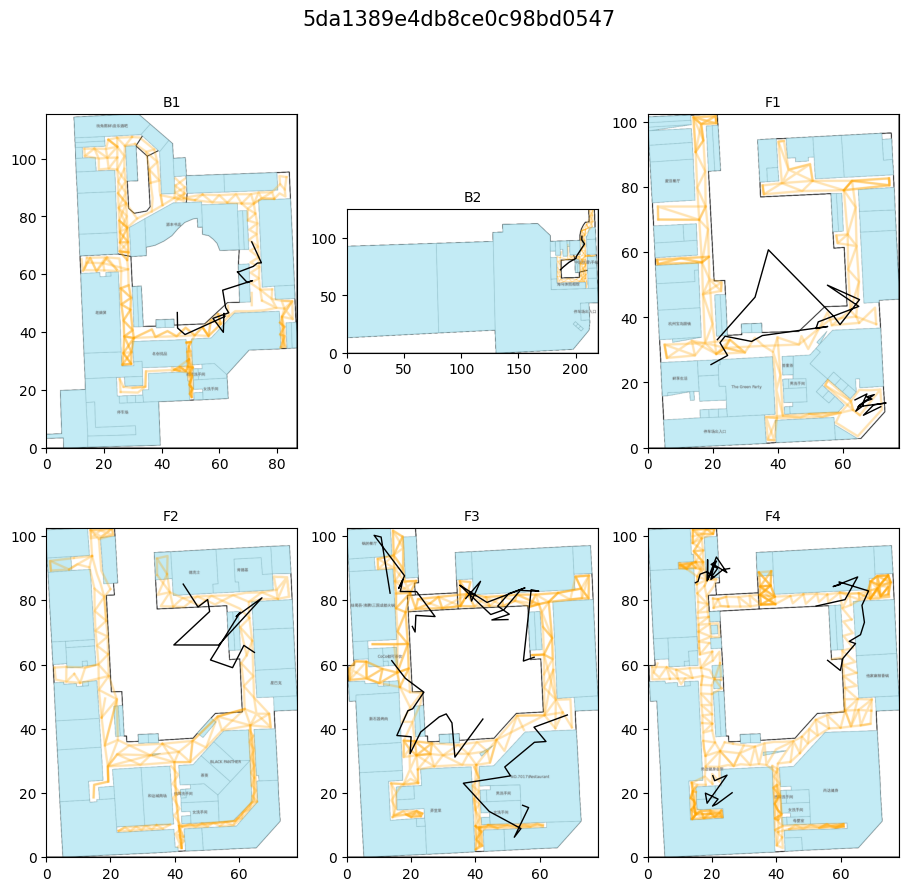

<ipython-input-6-5e217a208586>:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(n_row, 3, figsize=(w, h), dpi=dpi)


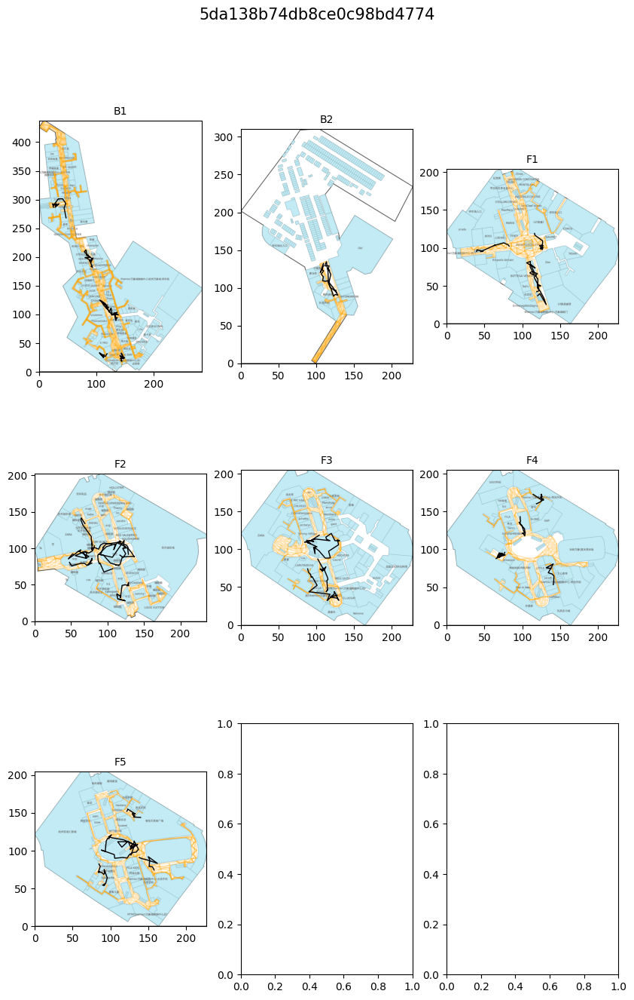

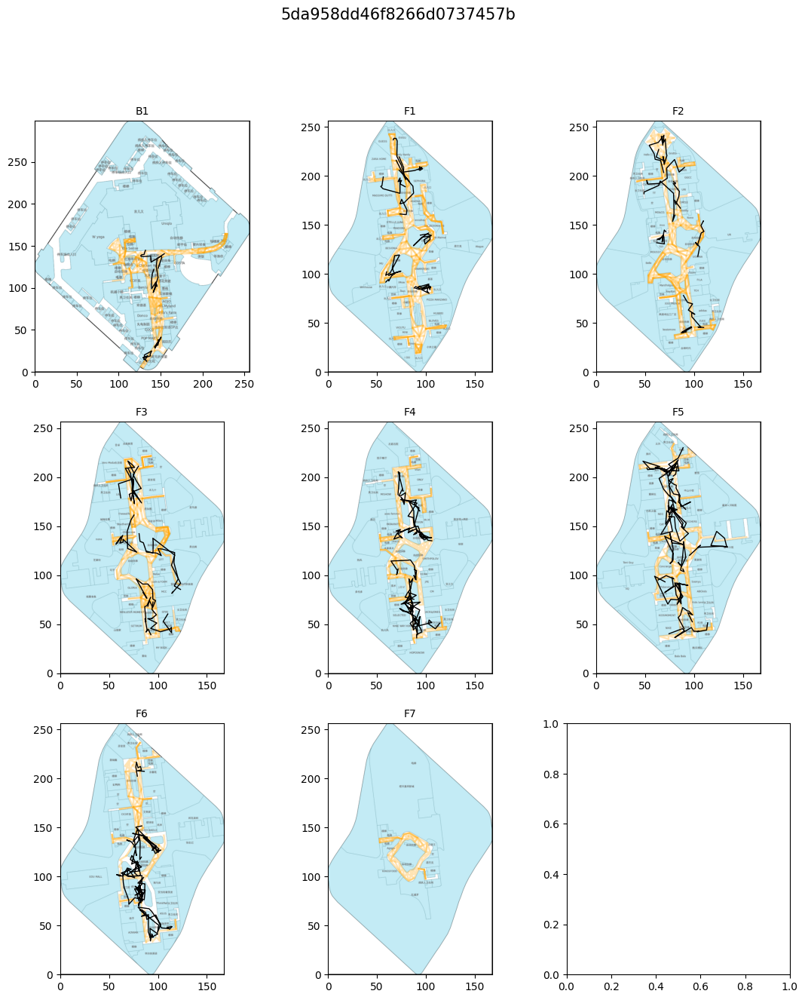

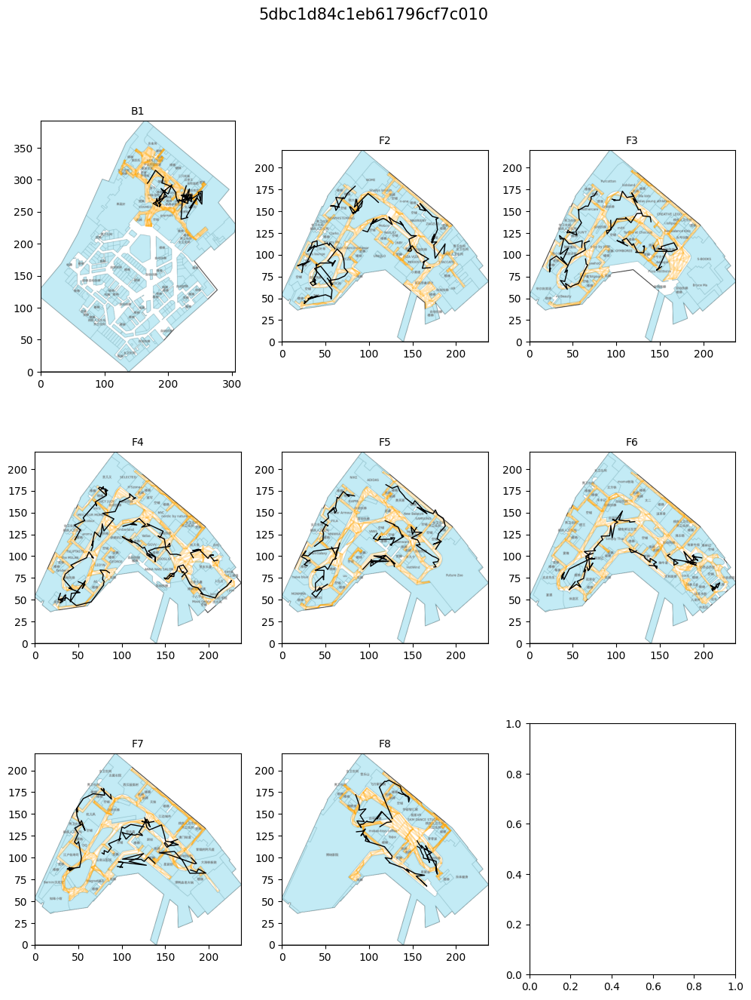

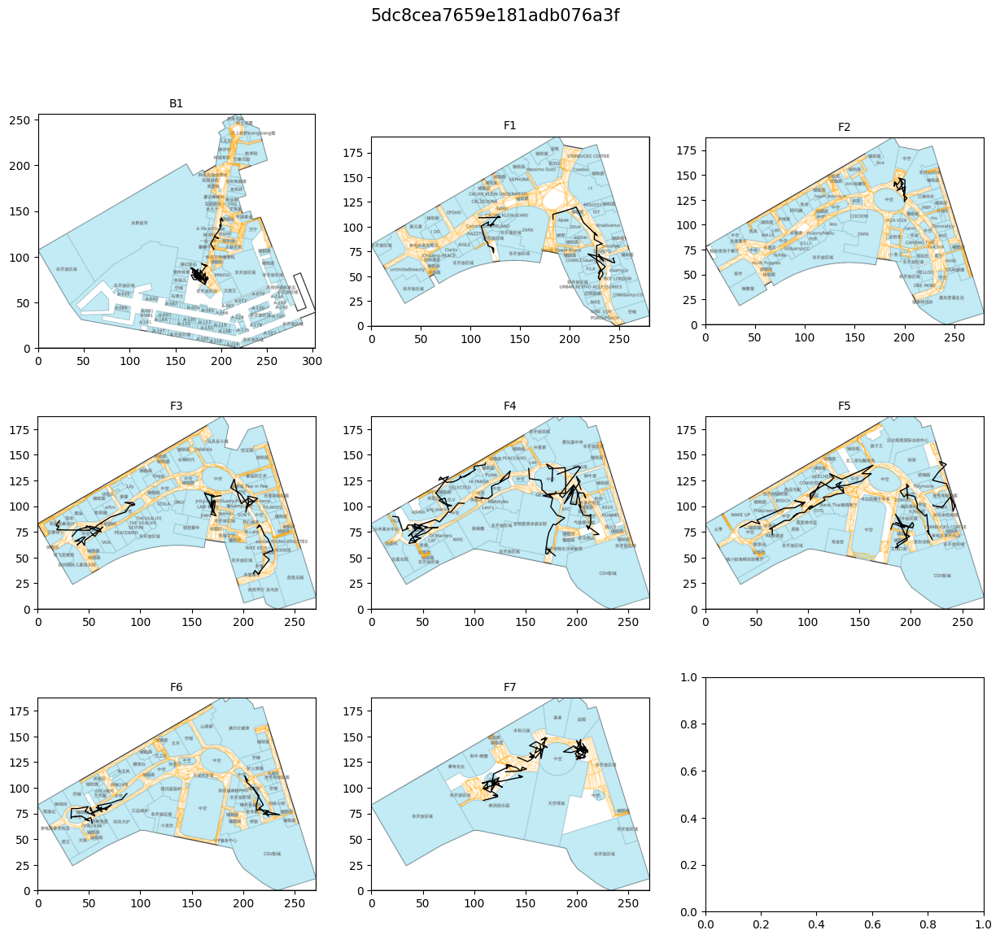

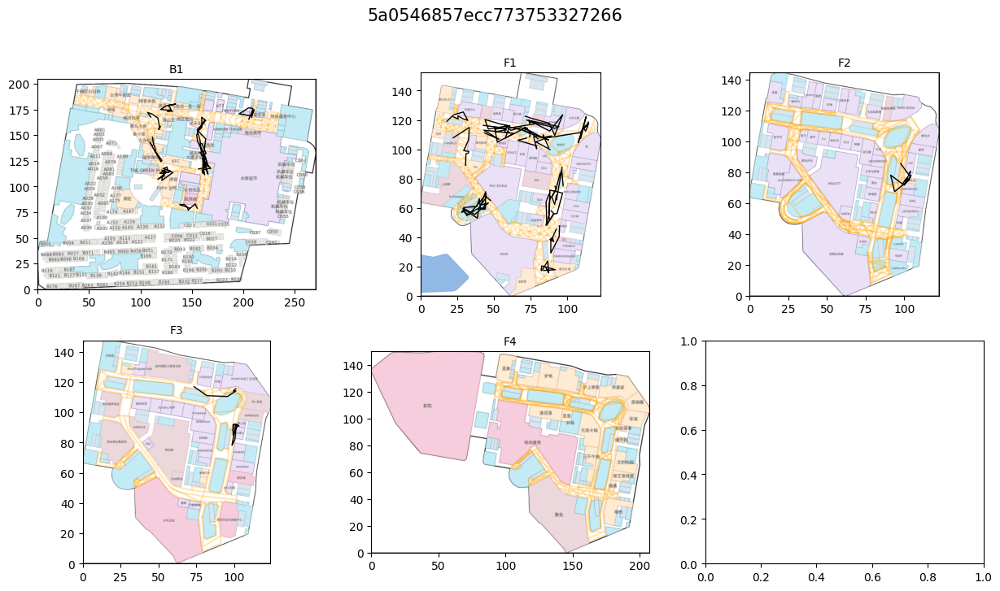

...

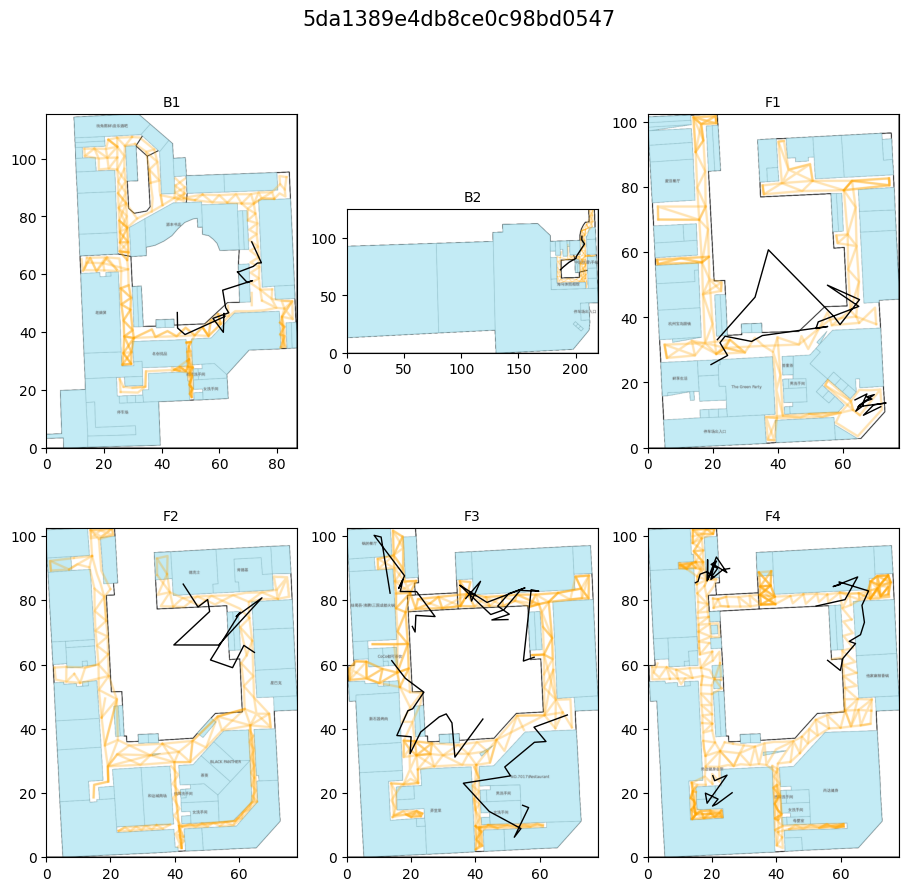

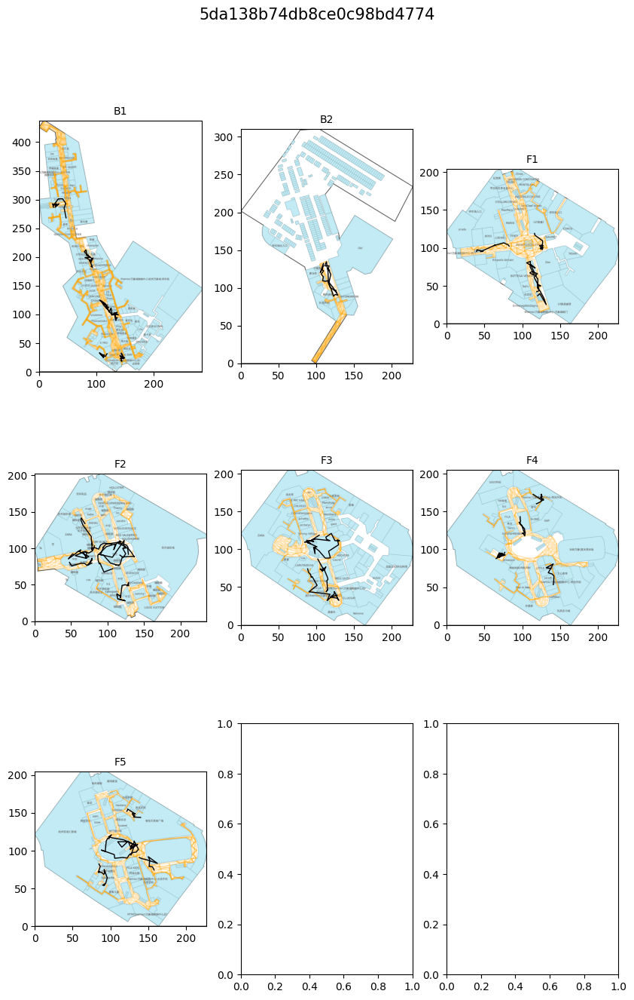

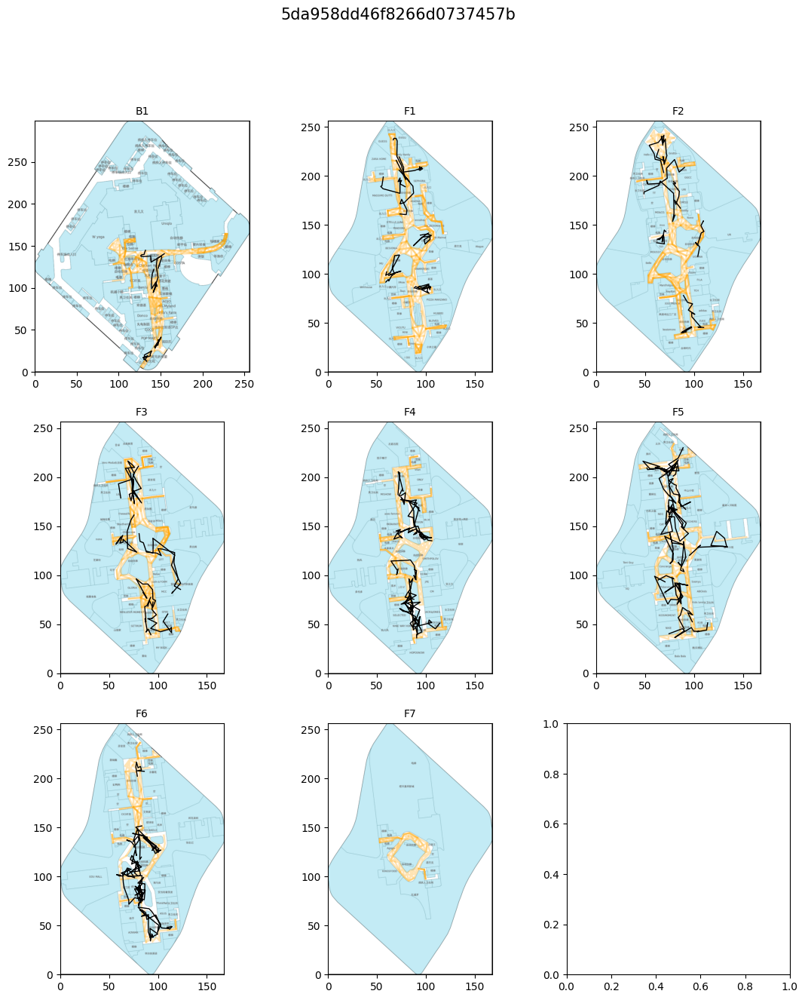

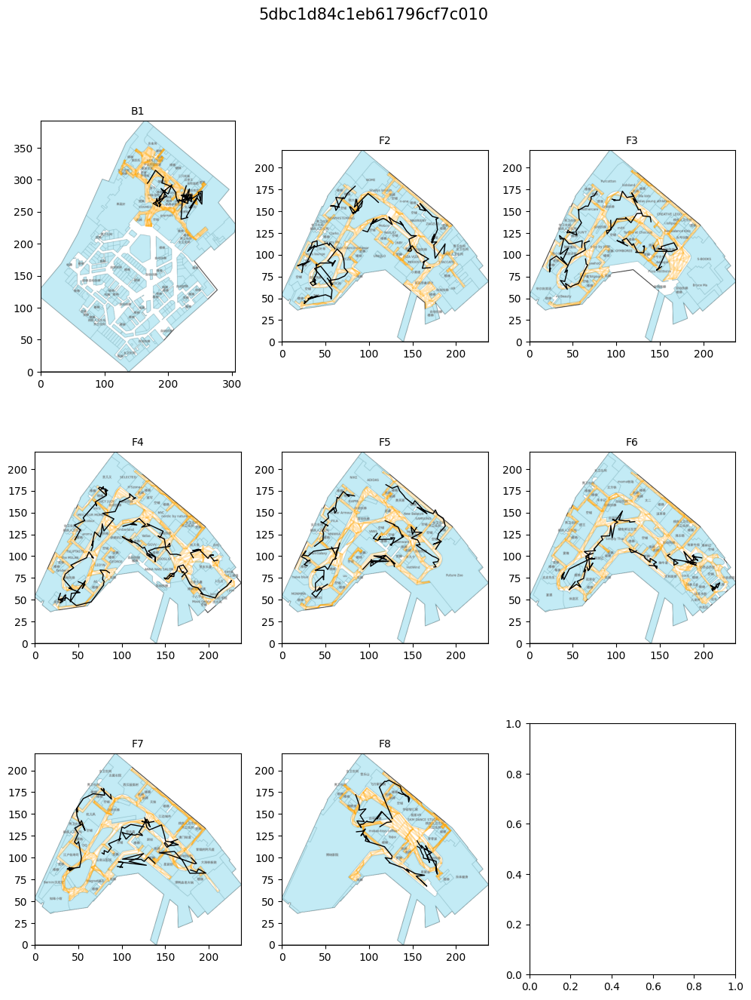

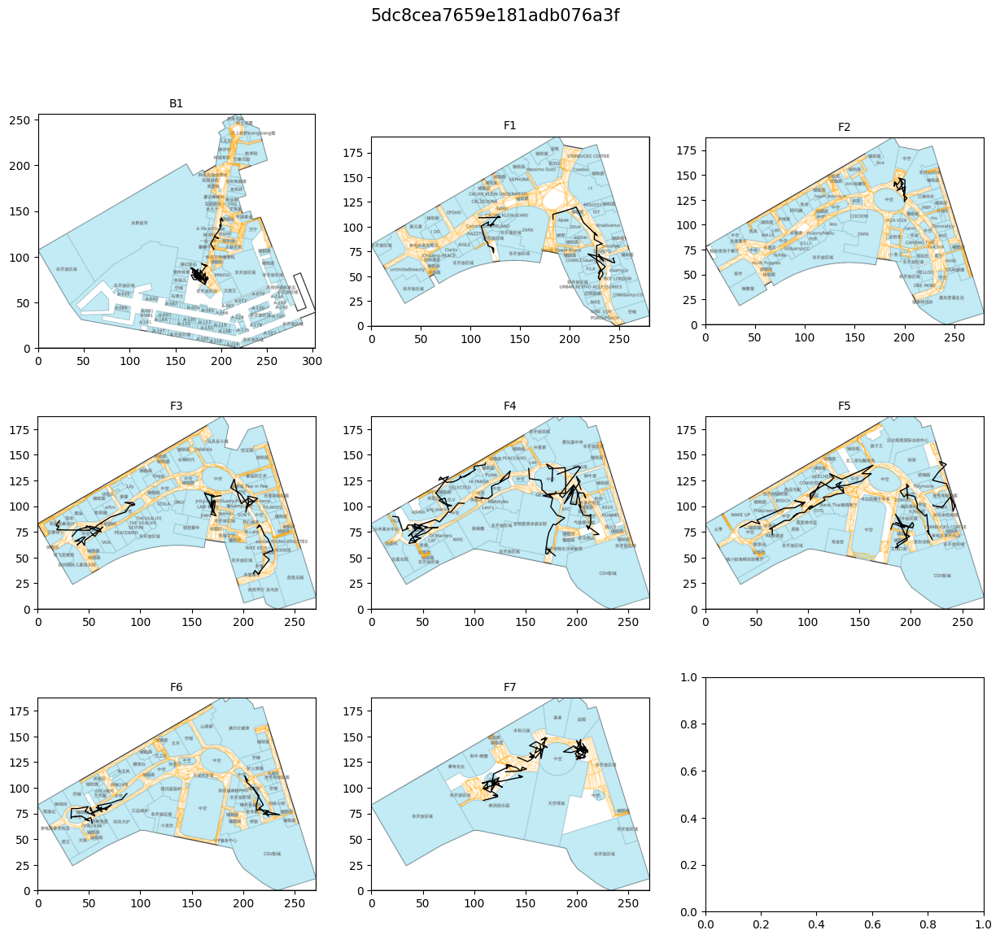

In [38]:
dpi = 100
visualize_submission(sub, './../data/nb/008/floor_images_with_trace/', './../data_ignore/input/metadata/', dpi=dpi)